In [1]:
import keras
import tensorflow as tf
import gdal
import os
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from keras_unet.models import custom_unet, satellite_unet
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras_unet.utils import plot_segm_history

-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


In [2]:
base_dir = Path(r'/media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2')
mask_dir = base_dir.joinpath('masks_img')
image_dir = Path(r'/media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/img')
water_dir = mask_dir.joinpath('water')
shrubs_dir = mask_dir.joinpath('shrub')
taiga_dir = mask_dir.joinpath('taiga')

In [3]:
test = gdal.Open(r'/media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/img/img_1.tif', gdal.GA_ReadOnly)

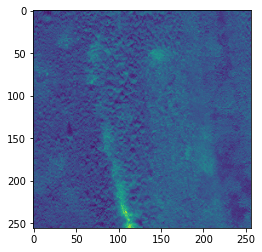

In [4]:
plt.imshow(test.GetRasterBand(1).ReadAsArray())

In [5]:
def make_path(img_dir, prefix, number):
    return os.path.join(img_dir, f"{prefix}_{number}.tif")

In [6]:
def img_number(fpath: str) -> int:
    return int(os.path.splitext(os.path.split(fpath)[1])[0].split('_')[-1])

In [7]:
import typing as t

def load_image_rgb(path: str, shape: t.Tuple[int,int,int], dtype) -> np.ndarray:
    image = np.zeros(shape = shape, dtype=dtype)
    ds= gdal.Open(path, gdal.GA_ReadOnly)
    for i in (1, 2, 3):
        image[:, :, i-1] = ds.GetRasterBand(i).ReadAsArray()
    return image



In [8]:
def load_image(path: str) -> np.ndarray:
    ds = gdal.Open(path, gdal.GA_ReadOnly)
    return ds.GetRasterBand(1).ReadAsArray()

In [9]:
def load_stack_rgb(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        # subsets for rgb bands only
        stack[i, :, :, :] = load_image_rgb(image_path, (shape[1], shape[2], shape[3]), dtype)
    return stack

# need to skip when there is no mask
# loads single band mask
def load_stack_safely(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        if not os.path.isfile(image_path):
            print("skipping", image_path)
            continue
        stack[i, :, :] = load_image(image_path)
    return stack

In [10]:
# training total data size
I = 225
# image dim 1
N = 256
# image dim 2
M = 256
# number of image bands
L = 3
# number of classes
V = 3

In [11]:
train_images = load_stack_rgb((I, N, M, L), np.int8, image_dir, "img")
train_images_R = train_images.reshape(I, N, M, L)

In [12]:
train_images_R.shape

(225, 256, 256, 3)

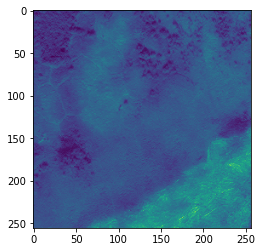

In [13]:
plt.imshow(train_images[1, :,:,1])

In [14]:
water_mask = load_stack_safely((I, N, M), np.int8, water_dir, "water")
taiga_mask = load_stack_safely((I, N, M), np.int8, taiga_dir, "taiga")
shrubs_mask = load_stack_safely((I, N, M), np.int8, shrubs_dir, "shrub")

skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_1.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_2.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_3.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_4.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_6.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_9.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_11.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_16.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/water/water_17.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks

skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_12.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_14.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_15.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_16.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_19.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_24.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_26.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_28.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2/masks_img/shrub/shrub_29.tif
skipping /media/hkropp/research/Kolyma_Data/training/Kolyma/v2/u_net_20v2

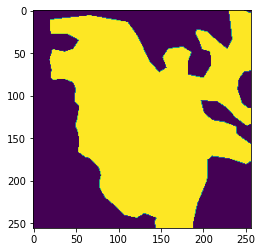

In [15]:
plt.imshow(taiga_mask[12, :,:])

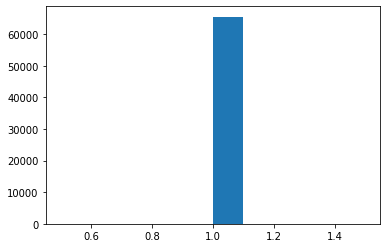

In [16]:
plt.hist(water_mask[4, :,:].flatten())
plt.show()

In [17]:
taiga_mask.shape

(225, 256, 256)

In [18]:
# Hold images 100-125 for testing threshold

W = 200
Y = np.zeros(shape=(W, N, M, V), dtype =np.int8)
Y_train_img = np.zeros(shape=(W, N, M, L), dtype =np.float32)

Y[0:100, :, :, 0] = taiga_mask[0:100, :, :]
Y[0:100, :, :, 1] = water_mask[0:100, :, :]
Y[0:100, :, :, 2] = shrubs_mask[0:100, :, :]
Y_train_img[0:100, :, :, :] = train_images_R[0:100, :, :, :]

Y[100:200, :, :, 0] = taiga_mask[125:225, :, :]
Y[100:200, :, :, 1] = water_mask[125:225, :, :]
Y[100:200, :, :, 2] = shrubs_mask[125:225, :, :]
Y_train_img[100:200, :, :, :] = train_images_R[125:225, :, :, :]




In [19]:
K = 25
Y_valid = np.zeros(shape=(K, N, M, V), dtype =np.int8)
Y_valid_img = np.zeros(shape=(K, N, M, L), dtype =np.float32)

Y_valid[0:25, :, :, 0] = taiga_mask[100:125, :, :]
Y_valid[0:25, :, :, 1] = water_mask[100:125, :, :]
Y_valid[0:25, :, :, 2] = shrubs_mask[100:125, :, :]
Y_valid_img[0:25, :, :, :] = train_images_R[100:125, :, :, :]

In [20]:
Y.shape

(200, 256, 256, 3)

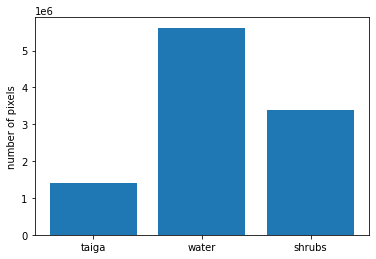

In [21]:
fig, ax = plt.subplots()
ax.bar(range(V), [taiga_mask.sum(), water_mask.sum(), shrubs_mask.sum()])
ax.set_xticks((0, 1, 2))
ax.set_xticklabels(('taiga', 'water', 'shrubs',))
plt.ylabel('number of pixels')
plt.show()

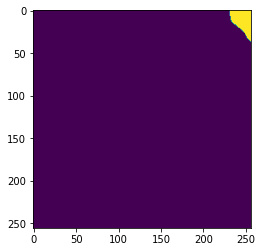

In [27]:
plt.imshow(Y[199,:,:,2])

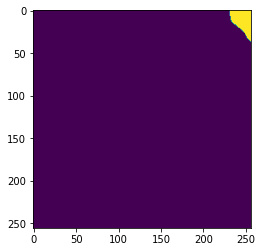

In [29]:
plt.imshow(shrubs_mask[224,:, :])

In [30]:
Y_train_img[50,:,:,2]

array([[20., 19., 20., ..., 24., 25., 24.],
       [18., 19., 20., ..., 24., 23., 24.],
       [20., 20., 19., ..., 24., 24., 24.],
       ...,
       [21., 21., 22., ..., 23., 24., 22.],
       [23., 21., 21., ..., 23., 22., 26.],
       [20., 23., 21., ..., 24., 24., 25.]], dtype=float32)

In [31]:
model = satellite_unet((N, M, 3), 3)

In [32]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = "binary_crossentropy",
    metrics = [iou, iou_thresholded],
)

In [33]:
history = model.fit(Y_train_img, Y, epochs = 50)

Epoch 1/50
7/7 [==============================] - 97s 11s/step - loss: 0.5452 - iou: 0.3935 - iou_thresholded: 0.4877
Epoch 2/50
4/7 [================>.............] - ETA: 36s - loss: 0.2454 - iou: 0.5905 - iou_thresholded: 0.6825

KeyboardInterrupt: 

In [34]:
plt.plot(history.history['iou'])

NameError: name 'history' is not defined

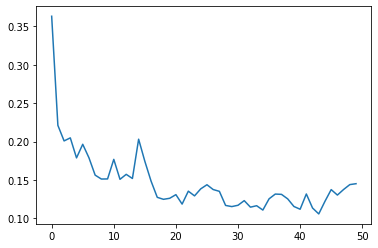

In [124]:
plt.plot(history.history['loss'])

In [34]:
modelsave_path = Path(r'/media/hkropp/research/Kolyma_Data/training/v2/model/2020')

In [35]:
model.save(modelsave_path)

INFO:tensorflow:Assets written to: /media/hkropp/research/Kolyma_Data/training/v2/model/2020/assets


INFO:tensorflow:Assets written to: /media/hkropp/research/Kolyma_Data/training/v2/model/2020/assets


In [127]:
Y_pred = model.predict(Y_train_img)

8/8 [==============================] - 11s 1s/step


In [131]:
Y_pred.shape

(225, 256, 256, 2)

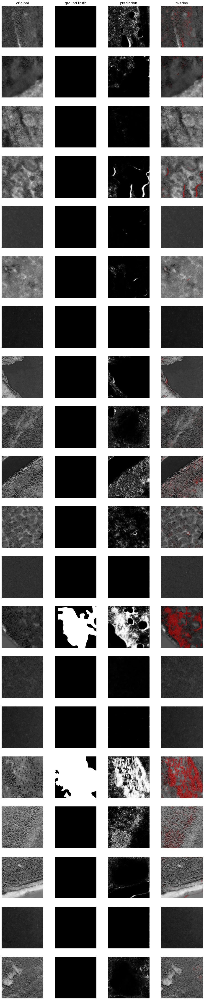

In [115]:
from keras_unet.utils import plot_imgs

# trees
plot_imgs(
    org_imgs=Y_train_img.reshape(225, N, M, 3)[:,:,:,0], 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

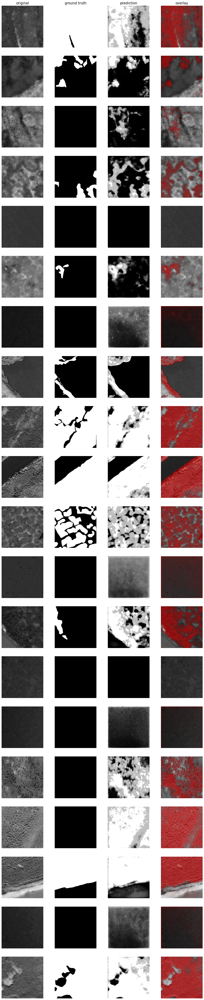

In [128]:
# Shrubs
plot_imgs(
    org_imgs=Y_train_img.reshape(225, N, M, 3)[:,:,:,0], 
    mask_imgs=Y[:, :, :, 1], 
    pred_imgs=Y_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

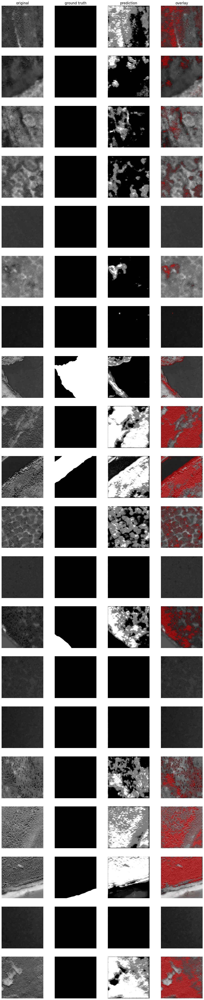

In [129]:
# water
plot_imgs(
    org_imgs=Y_train_img.reshape(225, N, M, 3)[:,:,:,0], 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

In [41]:
valid_pred = model.predict(Y_valid_img)

1/1 [==============================] - 1s 1s/step


In [42]:
valid_pred[1,:, :, 0]

array([[4.2083856e-02, 1.1734110e-01, 2.1144701e-02, ..., 7.7766529e-03,
        3.9142864e-03, 1.0791504e-02],
       [3.4501247e-02, 3.2659896e-02, 7.9982644e-03, ..., 1.6983075e-03,
        6.8805803e-04, 3.6986033e-03],
       [8.0482829e-03, 1.9571003e-02, 1.3498842e-02, ..., 3.7892770e-03,
        3.0944089e-03, 5.7563996e-03],
       ...,
       [7.4385614e-03, 5.4251910e-03, 3.4184242e-03, ..., 9.0659036e-05,
        4.7119153e-03, 1.8320661e-02],
       [8.8456068e-03, 1.2504224e-02, 3.5504252e-03, ..., 8.2293036e-04,
        1.4462119e-02, 2.1327196e-02],
       [3.1199710e-02, 7.5092628e-03, 3.9620707e-03, ..., 7.6091647e-02,
        1.8476566e-02, 3.5353564e-02]], dtype=float32)

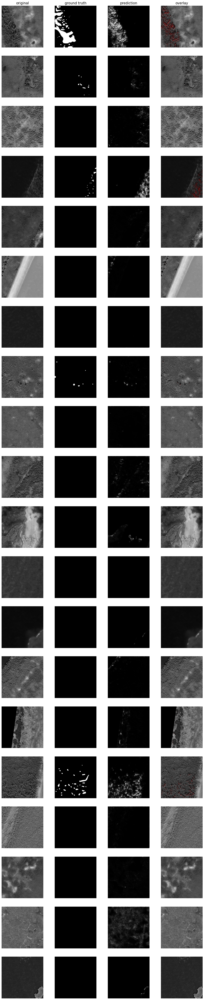

In [43]:
# Trees
plot_imgs(
    org_imgs=Y_valid_img.reshape(25, N, M, 3)[:,:,:,0], 
    mask_imgs=Y_valid[:, :, :, 0], 
    pred_imgs=valid_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

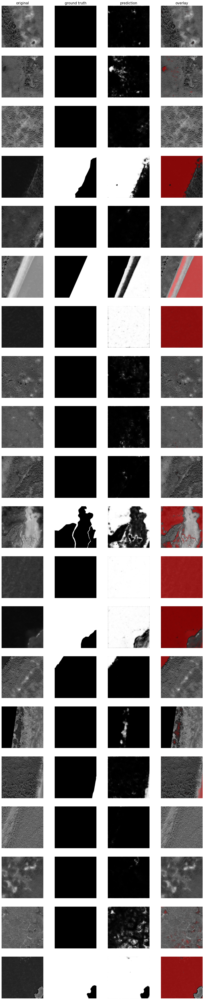

In [44]:
# Water
plot_imgs(
    org_imgs=Y_valid_img.reshape(25, N, M, 3)[:,:,:,0], 
    mask_imgs=Y_valid[:, :, :, 1], 
    pred_imgs=valid_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

In [45]:
waterPredict = valid_pred[:,:,:,1]

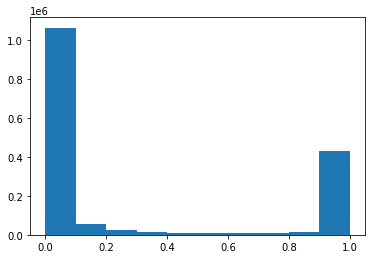

In [46]:
plt.hist(waterPredict.flatten())
plt.show()

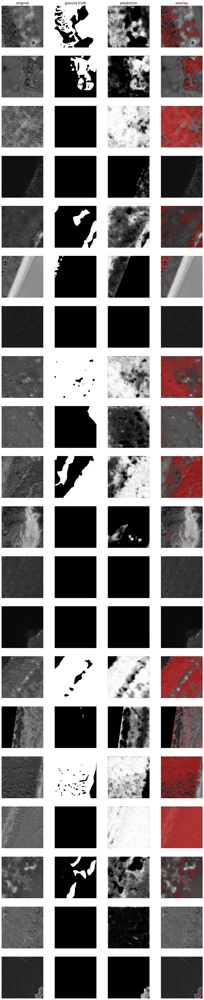

In [47]:
# Shrubs
plot_imgs(
    org_imgs=Y_valid_img.reshape(25, N, M, 3)[:,:,:,0], 
    mask_imgs=Y_valid[:, :, :, 2], 
    pred_imgs=valid_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

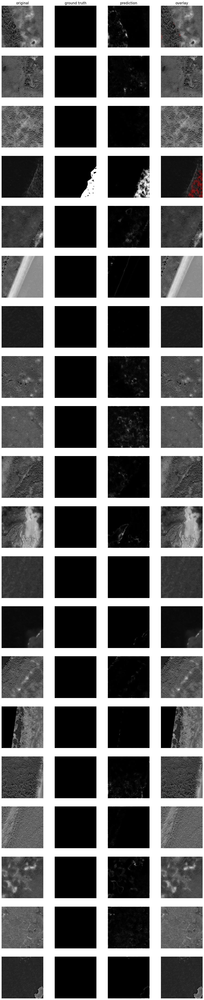

In [48]:
# Low density forest
plot_imgs(
    org_imgs=Y_valid_img.reshape(25, N, M, 3)[:,:,:,0], 
    mask_imgs=Y_valid[:, :, :, 3], 
    pred_imgs=valid_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

In [49]:
Y_valid[0,0,0,0]

0

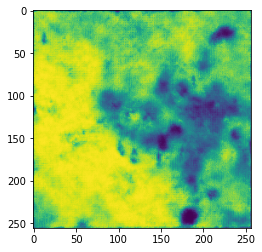

In [50]:
plt.imshow(valid_pred[7,:, :,2])

In [51]:
driver = gdal.GetDriverByName("GTiff")

In [52]:
driver.Register()

2

In [53]:
image_dir

PosixPath('/media/hkropp/research/Kolyma_Data/training/Kolyma/u_net20/training/img')

In [54]:
def save_predict_validT( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(0,25):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 100) 
        orig_ds = gdal.Open(orig_path, gdal.GA_ReadOnly)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i,:,:,0])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [55]:
tree_valid_dir = r'/media/hkropp/research/Kolyma_Data/training/eval/2020/tree'
save_predict_validT(nImg = 25,xdim= 256, ydim= 256,img_dir = tree_valid_dir,prefix = "tree_predict",orig_dir = image_dir, prefix_orig = "img")

In [56]:
def save_predict_validW( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(0,25):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 100) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i,:,:,1])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [57]:
water_valid_dir = r'/media/hkropp/research/Kolyma_Data/training/eval/2020/water'
save_predict_validW(nImg = 25,xdim= 256, ydim= 256,img_dir = water_valid_dir,prefix = "water_predict",orig_dir = image_dir , prefix_orig = "img")

In [58]:
def save_predict_validS( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(0,25):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 100) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i,:,:,2])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [59]:
shrub_valid_dir = r'/media/hkropp/research/Kolyma_Data/training/eval/2020/shrub'
save_predict_validS(nImg = 25,xdim= 256, ydim= 256,img_dir = shrub_valid_dir,prefix = "shrub_predict",orig_dir = image_dir , prefix_orig = "img")

In [60]:
def save_predict_validL( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(0,25):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 100) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i,:,:,3])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [61]:
lowD_valid_dir = r'/media/hkropp/research/Kolyma_Data/training/eval/2020/low'
save_predict_validL(nImg = 25,xdim= 256, ydim= 256,img_dir = lowD_valid_dir,prefix = "low_predict",orig_dir = image_dir , prefix_orig = "img")

In [62]:
base_dirP = Path(r'/media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256')

In [63]:
tiles = os.listdir(base_dirP)

In [64]:
T = len(tiles)

In [65]:
predict_img = load_stack_rgb((T, N, M, 3), np.int8,base_dirP, "img")

In [66]:
predict_img.shape

(12144, 256, 256, 3)

In [67]:
Y_all = model.predict(predict_img.reshape(T, N, M, 3))

380/380 [==============================] - 589s 2s/step


In [68]:
def save_predict_tree( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(base_dirP, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 0])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [69]:
tree_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020/tree'
save_predict_tree(nImg = T,xdim= 256, ydim= 256,img_dir = tree_pred_dir,prefix = "tree_predict",orig_dir = base_dirP , prefix_orig = "img")

In [70]:
def save_predict_water( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(base_dirP, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 1])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [71]:
water_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020/water'
save_predict_water(nImg = T,xdim= 256, ydim= 256,img_dir = water_pred_dir,prefix = "water_predict",orig_dir = base_dirP , prefix_orig = "img")

In [72]:
def save_predict_shrub( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(base_dirP, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 2])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [73]:
shrub_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020/shrub'
save_predict_shrub(nImg = T,xdim= 256, ydim= 256,img_dir = shrub_pred_dir,prefix = "shrub_predict",orig_dir = base_dirP , prefix_orig = "img")

In [74]:
def save_predict_lowD( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(base_dirP, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all[i, :, :, 3])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [75]:
lowD_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020/low'
save_predict_lowD(nImg = T,xdim= 256, ydim= 256,img_dir = lowD_pred_dir,prefix = "lowD_predict",orig_dir = base_dirP , prefix_orig = "img")

In [77]:
# check for partial tiles
imgD1 = np.zeros((T,2), dtype=int)



test = load_image(r'/media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_11.tif')

In [78]:
base_dirP2 = Path(r'/media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2')

tiles = os.listdir(base_dirP2)

T = len(tiles)

In [81]:
for i in range(T):
    tileLoad = load_image(make_path(base_dirP2, "img", i + 1))
    imgD1[i,0] = tileLoad.shape[0]
    imgD1[i,1] = tileLoad.shape[1]

In [82]:
imgFlag = np.zeros((T), dtype=int)

for i in range(T):
    if imgD1[i,0] < 256 or imgD1[i,1] < 256:
        imgFlag[i] = 1
    else:
        imgFlag[i] = 0

In [83]:
imgTable = np.zeros((T,2), dtype=int)
for i in range(T):
    imgTable[i,0] = imgFlag[i]
    imgTable[i,1] = i+1

In [84]:
imgTable

array([[    0,     1],
       [    0,     2],
       [    0,     3],
       ...,
       [    1, 12274],
       [    1, 12275],
       [    1, 12276]])

In [94]:
def load_stack_tiles(shape, dtype, img_dir, prefix, imgFlag):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        tilepath = make_path(img_dir, prefix, i + 1)
        if imgFlag[i,0] == 1:
            print("nullified", tilepath)
            stack[i,:,:,:] = np.zeros(shape = (shape[1], shape[2], shape[3]), dtype = dtype)
        else:
            stack[i, :,:,:] = load_image_rgb(tilepath, (shape[1], shape[2], shape[3]), dtype)
    return stack

In [95]:


predict_img2 = load_stack_tiles((T, N, M, 3), np.int8, base_dirP2, "img", imgTable)

predict_img2.shape

nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_93.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_186.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_279.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_372.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_465.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_558.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_651.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_744.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_837.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_930.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_1023.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_

nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9207.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9300.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9393.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9486.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9579.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9672.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9765.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9858.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_9951.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_10044.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_2/img_10137.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/til

(12276, 256, 256, 3)

In [97]:
Y_all2 = model.predict(predict_img2.reshape(T, N, M, 3))

384/384 [==============================] - 744s 2s/step


In [101]:
def save_predict_tree2( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all2[i, :, :, 0])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [102]:
tree_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_2/tree'
save_predict_tree2(nImg = T,xdim= 256, ydim= 256,img_dir = tree_pred_dir,prefix = "tree_predict",orig_dir = base_dirP2 , prefix_orig = "img") 

In [103]:
def save_predict_water2( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all2[i, :, :, 1])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [104]:
water_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_2/water'
save_predict_water2(nImg = T,xdim= 256, ydim= 256,img_dir = water_pred_dir,prefix = "water_predict",orig_dir = base_dirP2 , prefix_orig = "img")

In [105]:
def save_predict_shrub2( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all2[i, :, :, 2])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [106]:
shrub_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_2/shrub'
save_predict_shrub2(nImg = T,xdim= 256, ydim= 256,img_dir = shrub_pred_dir,prefix = "shrub_predict",orig_dir = base_dirP2 , prefix_orig = "img")

In [107]:
def save_predict_lowD2( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all2[i, :, :, 3])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [108]:
lowD_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_2/low'
save_predict_lowD2(nImg = T,xdim= 256, ydim= 256,img_dir = lowD_pred_dir,prefix = "lowD_predict",orig_dir = base_dirP2 , prefix_orig = "img")

In [109]:
# check for partial tiles
imgD1 = np.zeros((T,2), dtype=int)




test = load_image(r'/media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_11.tif')

In [110]:
base_dirP3 = Path(r'/media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3')

tiles = os.listdir(base_dirP3)

T = len(tiles)

In [111]:
for i in range(T):
    tileLoad = load_image(make_path(base_dirP3, "img", i + 1))
    imgD1[i,0] = tileLoad.shape[0]
    imgD1[i,1] = tileLoad.shape[1]

In [112]:
imgFlag = np.zeros((T), dtype=int)

for i in range(T):
    if imgD1[i,0] < 256 or imgD1[i,1] < 256:
        imgFlag[i] = 1
    else:
        imgFlag[i] = 0

In [113]:
imgTable = np.zeros((T,2), dtype=int)
for i in range(T):
    imgTable[i,0] = imgFlag[i]
    imgTable[i,1] = i+1

In [114]:
def load_stack_tiles(shape, dtype, img_dir, prefix, imgFlag):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        tilepath = make_path(img_dir, prefix, i + 1)
        if imgFlag[i,0] == 1:
            print("nullified", tilepath)
            stack[i,:,:,:] = np.zeros(shape = (shape[1], shape[2], shape[3]), dtype = dtype)
        else:
            stack[i, :,:,:] = load_image_rgb(tilepath, (shape[1], shape[2], shape[3]), dtype)
    return stack

In [115]:


predict_img3 = load_stack_tiles((T, N, M, 3), np.int8, base_dirP3, "img", imgTable)

predict_img3.shape

nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_92.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_184.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_276.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_368.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_460.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_552.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_644.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_736.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_828.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_920.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_1012.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_

nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9016.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9108.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9200.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9292.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9384.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9476.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9568.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9660.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9752.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9844.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles_256_3/img_9936.tif
nullified /media/hkropp/research/Kolyma_Data/img_tiles/2020/tiles

(12144, 256, 256, 3)

In [116]:
Y_all3 = model.predict(predict_img3.reshape(T, N, M, 3))

380/380 [==============================] - 937s 2s/step


In [117]:
def save_predict_tree3( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all3[i, :, :, 0])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [118]:
tree_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_3/tree'
save_predict_tree3(nImg = T,xdim= 256, ydim= 256,img_dir = tree_pred_dir,prefix = "tree_predict",orig_dir = base_dirP3 , prefix_orig = "img") 

In [119]:
def save_predict_water3( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all3[i, :, :, 1])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [120]:
water_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_3/water'
save_predict_water3(nImg = T,xdim= 256, ydim= 256,img_dir = water_pred_dir,prefix = "water_predict",orig_dir = base_dirP3 , prefix_orig = "img")

In [122]:
def save_predict_shrub3( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all3[i, :, :, 2])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [123]:
shrub_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_3/shrub'
save_predict_shrub3(nImg = T,xdim= 256, ydim= 256,img_dir = shrub_pred_dir,prefix = "shrub_predict",orig_dir = base_dirP3 , prefix_orig = "img")

In [124]:
def save_predict_lowD3( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(T):
        image_path = make_path(img_dir, prefix, i + 1)
        tilepath = make_path(orig_dir, prefix_orig, i+1)
        orig_ds = gdal.Open(tilepath)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTM = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTM.SetGeoTransform(gt)
        outTM.SetProjection(pt)
        outBandTreeM = outTM.GetRasterBand(1)
        outBandTreeM.WriteArray(Y_all3[i, :, :, 3])
        outBandTreeM.SetNoDataValue(np.nan)
        outBandTreeM.FlushCache()
        outBandTreeM = None
        outTreeM = None

In [125]:
lowD_pred_dir = r'/media/hkropp/research/Kolyma_Data/predictions/2020_3/low'
save_predict_lowD3(nImg = T,xdim= 256, ydim= 256,img_dir = lowD_pred_dir,prefix = "lowD_predict",orig_dir = base_dirP3 , prefix_orig = "img")